 Sentiment Analysis on Movie Reviews

# Data Exploration: Exploring the Dataset



In [6]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style('darkgrid')



In [7]:
from google.colab import files
 
 
uploaded = files.upload()

Saving IMDB Dataset.csv to IMDB Dataset.csv


In [8]:
import io
 
imdb_data = pd.read_csv(io.BytesIO(uploaded['IMDB Dataset.csv']))
print(imdb_data )

                                                  review sentiment
0      One of the other reviewers has mentioned that ...  positive
1      A wonderful little production. <br /><br />The...  positive
2      I thought this was a wonderful way to spend ti...  positive
3      Basically there's a family where a little boy ...  negative
4      Petter Mattei's "Love in the Time of Money" is...  positive
...                                                  ...       ...
49995  I thought this movie did a down right good job...  positive
49996  Bad plot, bad dialogue, bad acting, idiotic di...  negative
49997  I am a Catholic taught in parochial elementary...  negative
49998  I'm going to have to disagree with the previou...  negative
49999  No one expects the Star Trek movies to be high...  negative

[50000 rows x 2 columns]


In [9]:
import nltk
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

# Data Preproccessing

Here are some common preproccessing steps, feel free to add more preproccessing steps if needed: 
1. check missing values. 
2. remove noise and special characters, such as "\[[^]]*\]", etc.
3. transform all words to lower case, 
4. word tokenization  
5. stop words removing and stemming,
6. divide the dataset into train set (75%) and test set (25%) with random sampling

 ......

**Hint:**
* You may need TfidVectorizer class to convert a collection of raw documents to a matrix of TF-IDF features: https://scikit-learn.org/stable/modules/generated/sklearn.feature_extraction.text.TfidfVectorizer.html, 
* You are also welcome to use the Python Natural Language Processing Toolkit (www.nltk.org).
 


In [10]:
import pandas as pd
import re
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from sklearn.model_selection import train_test_split



# Check for missing values
print(imdb_data.isnull().sum())

# Remove noise and special characters
imdb_data['review'] = imdb_data['review'].apply(lambda x: re.sub('[^a-zA-Z0-9\s]', '', x))

# Transform all words to lower case
imdb_data['review'] = imdb_data['review'].apply(lambda x: x.lower())

# Word tokenization
imdb_data['review'] = imdb_data['review'].apply(lambda x: word_tokenize(x))

# Stop words removing and stemming
stop_words = set(stopwords.words('english'))
stemmer = PorterStemmer()

imdb_data['review'] = imdb_data['review'].apply(lambda x: [stemmer.stem(word) for word in x if word not in stop_words])

# Divide dataset into train and test sets
X = imdb_data['review']
y = imdb_data['sentiment']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)


review       0
sentiment    0
dtype: int64


In [16]:
pip install Keras-Preprocessing

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 42.6/42.6 KB 2.3 MB/s eta 0:00:00


# Data Modelling

* Please use the following models to classify the data:
    * Logistic Regression
    * LinearSVC
    * KNeighborsClassifier
    * Fully-connected layers, please try different number of hidden layers, different values of "hidden_layer_sizes" and "activation".
    * CNN (please use different number of convolutional layers combined with different number of fully-connected layers, and compare the results).


In [38]:
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#Logistic Regression
import pandas as pd
import re
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.svm import LinearSVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, confusion_matrix
from keras.preprocessing.text import Tokenizer
from keras_preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.layers import Embedding, Conv1D, MaxPooling1D, Flatten, Dense, Dropout


# Convert text data to numeric using TfidfVectorizer
vectorizer = TfidfVectorizer(stop_words='english')
X_train = vectorizer.fit_transform([' '.join(review) for review in X_train])
X_test = vectorizer.transform([' '.join(review) for review in X_test])

# Logistic Regression
lr = LogisticRegression()
lr.fit(X_train, y_train)
lr_pred = lr.predict(X_test)
print("Logistic Regression Accuracy:", accuracy_score(y_test, lr_pred))
print("Logistic Regression Confusion Matrix:\n", confusion_matrix(y_test, lr_pred))



Logistic Regression Accuracy: 0.89112
Logistic Regression Confusion Matrix:
 [[5398  759]
 [ 602 5741]]


In [46]:
# LinearSVC
svc = LinearSVC()
svc.fit(X_train, y_train)
svc_pred = svc.predict(X_test)
print("LinearSVC Accuracy:", accuracy_score(y_test, svc_pred))
print("LinearSVC Confusion Matrix:\n", confusion_matrix(y_test, svc_pred))




LinearSVC Accuracy: 0.89496
LinearSVC Confusion Matrix:
 [[5437  720]
 [ 593 5750]]


In [21]:
# KNeighborsClassifier
knn = KNeighborsClassifier()
knn.fit(X_train, y_train)
knn_pred = knn.predict(X_test)
print("KNeighborsClassifier Accuracy:", accuracy_score(y_test, knn_pred))
print("KNeighborsClassifier Confusion Matrix:\n", confusion_matrix(y_test, knn_pred))



KNeighborsClassifier Accuracy: 0.78032
KNeighborsClassifier Confusion Matrix:
 [[4372 1785]
 [ 961 5382]]


In [43]:
# MLPClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.preprocessing import StandardScaler

sc=StandardScaler(with_mean=False)

scaler = sc.fit(X_train)
trainX_scaled = scaler.transform(X_train)
testX_scaled = scaler.transform(X_test)

# Define the MLPClassifier model
mlp = MLPClassifier()

# Set up a list of hidden layer sizes to try
hidden_layer_sizes_list = [(5,2), (10,4), (100,50,30)]

# Set up a list of activation functions to try
activation_functions_list = ['relu','tanh']

# Loop over different combinations of hidden layer sizes and activation functions
for hidden_layer_sizes in hidden_layer_sizes_list:
    for activation_function in activation_functions_list:
        
        # Set the hidden layer sizes and activation function
        mlp.set_params(hidden_layer_sizes=hidden_layer_sizes, activation=activation_function)
        
        # Fit the model on the training data
        mlp.fit(trainX_scaled, y_train)
        
        # Calculate the accuracy on the test data
        accuracy = mlp.score(testX_scaled, y_test)
        
        # Print the results
        print(f"Hidden layer sizes: {hidden_layer_sizes}, activation function: {activation_function}, accuracy: {accuracy:.3f}")

Hidden layer sizes: (5, 2), activation function: relu, accuracy: 0.835
Hidden layer sizes: (5, 2), activation function: tanh, accuracy: 0.815
Hidden layer sizes: (10, 4), activation function: relu, accuracy: 0.830
Hidden layer sizes: (10, 4), activation function: tanh, accuracy: 0.832
Hidden layer sizes: (100, 50, 30), activation function: relu, accuracy: 0.840
Hidden layer sizes: (100, 50, 30), activation function: tanh, accuracy: 0.834


In [64]:
# CNN. Please use scrollbar to scroll down
max_words = 20000
max_len = 200
tokenizer = Tokenizer(num_words=max_words)
tokenizer.fit_on_texts([' '.join(str(review)) for review in X_train])
X_train_seq = tokenizer.texts_to_sequences([' '.join(str(review)) for review in X_train])
X_train_seq

[[1,
  2,
  3,
  10,
  9,
  5,
  1,
  1,
  4,
  5,
  1,
  8,
  5,
  3,
  5,
  1,
  6,
  4,
  4,
  7,
  6,
  5,
  10,
  1,
  5,
  7,
  1,
  3,
  5,
  1,
  2,
  9,
  9,
  7,
  7,
  8,
  9,
  1,
  4,
  9,
  7,
  2,
  8,
  1,
  2,
  6,
  9,
  1,
  9,
  8,
  6,
  9,
  3,
  1,
  2,
  6,
  8,
  10,
  5,
  8,
  10,
  8,
  5,
  1,
  7,
  5,
  3,
  3,
  3,
  3,
  1,
  4,
  9,
  9,
  7,
  9,
  1,
  2,
  3,
  3,
  10,
  7,
  10,
  8,
  4,
  3,
  3,
  9,
  6,
  8,
  10,
  5,
  5,
  4,
  1,
  2,
  1,
  8,
  2,
  10,
  1,
  1,
  1,
  9,
  9,
  1,
  2,
  5,
  8,
  1,
  6,
  7,
  5,
  4,
  3,
  7,
  4,
  2,
  6,
  1,
  8,
  3,
  8,
  2,
  7,
  1,
  2,
  3,
  6,
  9,
  6,
  1,
  4,
  3,
  7,
  8,
  1,
  5,
  8,
  6,
  6,
  7,
  7,
  1,
  4,
  8,
  8,
  2,
  10,
  1,
  2,
  2,
  10,
  3,
  6,
  8,
  9,
  3,
  3,
  1,
  3,
  5,
  3,
  8,
  6,
  1,
  7,
  1,
  2,
  1,
  8,
  10,
  5,
  5,
  1,
  2,
  7,
  8,
  7,
  1,
  8,
  2,
  2,
  7,
  10,
  3,
  8,
  10,
  6,
  10,
  8,
  3,
  1,
  4,
  6,
  6,
  1,
 

# Results: summarize and visualize the results discovered from the analysis

Please use figures or tables to present the results.


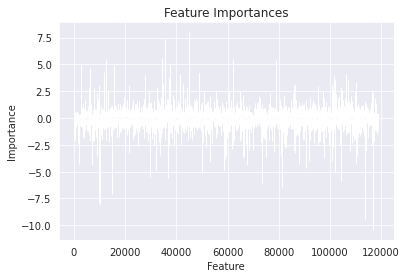

In [44]:
# Your code starts here
#   Please add comments or text cells in between to explain the general idea of each block of the code.
#   Please feel free to add more cells below this cell if necessary

# Create a bar chart of feature importance
importances = lr.coef_[0]
plt.bar(range(len(importances)), importances)
plt.title("Feature Importances")
plt.xlabel("Feature")
plt.ylabel("Importance")
plt.show()

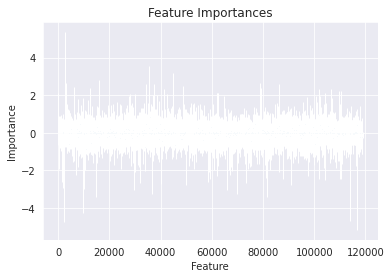

In [47]:
# Create a bar chart of feature importance
importances = svc.coef_[0]
plt.bar(range(len(importances)), importances)
plt.title("Feature Importances")
plt.xlabel("Feature")
plt.ylabel("Importance")
plt.show()

In [84]:
#normalized train reviews
norm_train_reviews=imdb_data.review[:40000]
norm_train_reviews[0]
#convert dataframe to string
#norm_train_string=norm_train_reviews.to_string()
#Spelling correction using Textblob
#norm_train_spelling=TextBlob(norm_train_string)
#norm_train_spelling.correct()
#Tokenization using Textblob
#norm_train_words=norm_train_spelling.words
#norm_train_words

#Normalized test reviews
norm_test_reviews=imdb_data.review[40000:]
norm_test_reviews[45005]
##convert dataframe to string
#norm_test_string=norm_test_reviews.to_string()
#spelling correction using Textblob
#norm_test_spelling=TextBlob(norm_test_string)
#print(norm_test_spelling.correct())
#Tokenization using Textblob
#norm_test_words=norm_test_spelling.words
#norm_test_word


['read',
 'review',
 'watch',
 'piec',
 'cinemat',
 'garbag',
 'took',
 'least',
 '2',
 'page',
 'find',
 'somebodi',
 'els',
 'didnt',
 'think',
 'appallingli',
 'unfunni',
 'montag',
 'wasnt',
 'acm',
 'humour',
 '70',
 'inde',
 'era',
 'isnt',
 'least',
 'funni',
 'set',
 'sketch',
 'comedi',
 'ive',
 'ever',
 'seen',
 'itll',
 'till',
 'come',
 'along',
 'half',
 'skit',
 'alreadi',
 'done',
 'infinit',
 'better',
 'act',
 'monti',
 'python',
 'woodi',
 'allen',
 'say',
 'nice',
 'piec',
 'anim',
 'last',
 '90',
 'second',
 'highlight',
 'film',
 'would',
 'still',
 'get',
 'close',
 'sum',
 'mindless',
 'drivelridden',
 'wast',
 '75',
 'minut',
 'semin',
 'comedi',
 'world',
 'semin',
 'realli',
 'mean',
 'semen',
 'scatolog',
 'humour',
 'world',
 'scat',
 'actual',
 'fece',
 'precursor',
 'joke',
 'mean',
 'handbook',
 'comedi',
 'tit',
 'bum',
 'odd',
 'beaver',
 'niceif',
 'pubesc',
 'boy',
 'least',
 'one',
 'hand',
 'free',
 'havent',
 'found',
 'playboy',
 'exist',
 'give',

<function matplotlib.pyplot.show(close=None, block=None)>

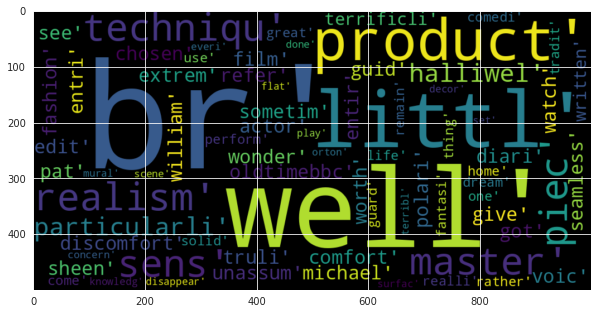

In [91]:
#word cloud for positive review words
from wordcloud import WordCloud
plt.figure(figsize=(10,10))
positive_text=norm_train_reviews[1]
WC=WordCloud(width=1000,height=500,max_words=500,min_font_size=5)
positive_words=WC.generate(str(positive_text))
plt.imshow(positive_words,interpolation='bilinear')
plt.show

<function matplotlib.pyplot.show(close=None, block=None)>

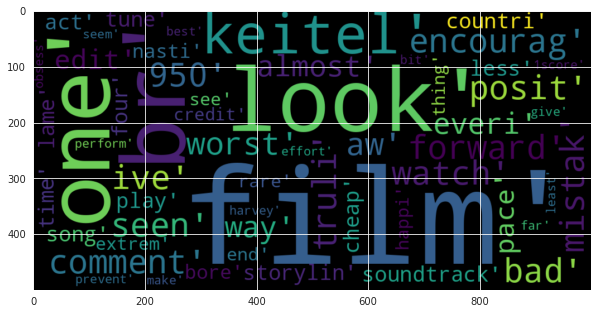

In [93]:
#Word cloud for negative review words
plt.figure(figsize=(10,10))
negative_text=norm_train_reviews[8]
WC=WordCloud(width=1000,height=500,max_words=500,min_font_size=5)
negative_words=WC.generate(str(negative_text))
plt.imshow(negative_words,interpolation='bilinear')
plt.show


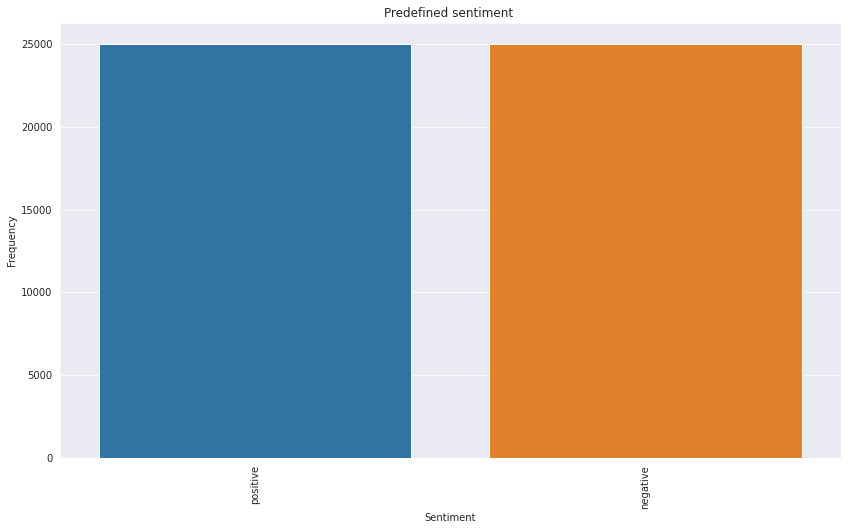

positive    25000
negative    25000
Name: sentiment, dtype: int64


In [99]:
sns.set_style("darkgrid")
plt.figure(figsize=(14,8))
ax = sns.countplot(x="sentiment", data=imdb_data)
ax.set(xlabel = "Sentiment", ylabel = "Frequency")
ax.set_title("Predefined sentiment ")
#ax.set(ylim=(ylim1,ylim2))
plt.xticks(rotation=90)
plt.show()
print(imdb_data['sentiment'].value_counts())


# Done

All set! 

**What do you need to submit?**

* **Notebook File**: Save this Jupyter notebook. Please make sure all the plotted tables and figures are in the notebook. 

* **PDF Report**: please prepare a report in the PDF form which should be at least 4 pages. The report should includes:

  * Data description and exploration.

  * Data preproccessing.

  * Data modelling.

  * What did you find in the data?

  * (please include figures or tables in the report, but no source code)
  
Please compress all the files in a zipped file.